## Transfer Learning (Faster R-CNN ResNet)



## 1. Install required libraries

In [1]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI


In [2]:
%tensorflow_version 1.x  # Version 1 is better suited for transfer learning
!pip show tensorflow

`%tensorflow_version` only switches the major version: 1.x or 2.x.
You set: `1.x  # Version 1 is better suited for transfer learning`. This will be interpreted as: `1.x`.


TensorFlow 1.x selected.
Name: tensorflow
Version: 1.15.2
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /tensorflow-1.15.2/python3.6
Requires: keras-preprocessing, keras-applications, tensorflow-estimator, wrapt, termcolor, protobuf, gast, grpcio, opt-einsum, wheel, six, astor, google-pasta, absl-py, tensorboard, numpy
Required-by: stable-baselines, magenta, fancyimpute


In [3]:
!pip install tf_slim   # Dependency. Removed from recent versions of tensorflow

     |████████████████████████████████| 358kB 9.3MB/s 


## 2. Clone the tensorflow github repo. Contains requirements to run and train pre-trained models.

In [ ]:
!git clone https://github.com/tensorflow/models.git # Import required models from Github

Cloning into 'models'...
remote: Enumerating objects: 11, done.
remote: Counting objects: 100% (11/11), done.
remote: Compressing objects: 100% (11/11), done.
remote: Total 40618 (delta 2), reused 7 (delta 0), pack-reused 40607
Receiving objects: 100% (40618/40618), 548.73 MiB | 13.91 MiB/s, done.
Resolving deltas: 100% (27430/27430), done.
Checking out files: 100% (1824/1824), done.


## 3. Download and install Tensorboard to track the model training in real-time.

In [ ]:
!wget https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
!unzip -o ngrok-stable-linux-amd64.zip

--2020-08-04 17:09:26--  https://bin.equinox.io/c/4VmDzA7iaHb/ngrok-stable-linux-amd64.zip
Resolving bin.equinox.io (bin.equinox.io)... 52.21.175.83, 3.213.224.216, 52.200.98.137, ...
Connecting to bin.equinox.io (bin.equinox.io)|52.21.175.83|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13773305 (13M) [application/octet-stream]
Saving to: ‘ngrok-stable-linux-amd64.zip’

ngrok-stable-linux- 100%[===================>]  13.13M  5.90MB/s    in 2.2s    

2020-08-04 17:09:29 (5.90 MB/s) - ‘ngrok-stable-linux-amd64.zip’ saved [13773305/13773305]

Archive:  ngrok-stable-linux-amd64.zip
  inflating: ngrok                   


#### Create Log directory and enable Tensorboard.

In [ ]:
#the logs that are created while training 
LOG_DIR = "/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/trained/"
get_ipython().system_raw(
    'tensorboard --logdir {} --host 0.0.0.0 --port 6006 &'
    .format(LOG_DIR)
)
get_ipython().system_raw('./ngrok http 6006 &')
#The link to tensorboard.
#works after the training starts.
!curl -s http://localhost:4040/api/tunnels | python3 -c \
    "import sys, json; print(json.load(sys.stdin)['tunnels'][0]['public_url'])"

https://1584f8d50b22.ngrok.io


#### Compile Protobuf and and change Python path.

In [ ]:
%ls

models/  ngrok*  ngrok-stable-linux-amd64.zip  support_files/


In [4]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/slim/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/utils/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection'
!python object_detection/builders/model_builder_test.py

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research


## 4. Generate tf-records

In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI
%ls

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI
models/  ngrok*  ngrok-stable-linux-amd64.zip  support_files/


In [ ]:
%mkdir -p models/bdd/data

In [ ]:
%cd models/bdd/data

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data


In [ ]:
# Upload train.csv and test.csv
from google.colab import files
uploaded = files.upload()


Saving test_labels.csv to test_labels.csv
Saving train_labels.csv to train_labels.csv
Saving val_labels.csv to val_labels.csv


In [ ]:
%ls
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/support_files

faster_rcnn_resnet101_kitti.config  test_labels.csv   train.record
object_detection.pbtxt              test.record       val_labels.csv
ssd_mobilenet_v1_coco.config        train_labels.csv
/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/support_files


In [ ]:
# Upload generate_tfrecord.py
from google.colab import files
uploaded = files.upload()

Saving generate_tfrecord.py to generate_tfrecord.py


In [ ]:
!python generate_tfrecord.py --csv_input=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/train_labels.csv  --output_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/train.record --image_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/data/train
!python generate_tfrecord.py --csv_input=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/test_labels.csv  --output_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/test.record --image_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/data/test




W0804 13:51:10.576947 139969906927488 module_wrapper.py:139] From generate_tfrecord.py:114: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0804 13:51:13.695619 139969906927488 module_wrapper.py:139] From generate_tfrecord.py:73: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/train.record


W0804 14:30:04.164304 139822738757504 module_wrapper.py:139] From generate_tfrecord.py:114: The name tf.python_io.TFRecordWriter is deprecated. Please use tf.io.TFRecordWriter instead.


W0804 14:30:06.837152 139822738757504 module_wrapper.py:139] From generate_tfrecord.py:73: The name tf.gfile.GFile is deprecated. Please use tf.io.gfile.GFile instead.

Successfully created the TFRecords: /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/test.record


## 5. Download pre-trained model checkpoint

Model: SSD MobileNet Coco v1

In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/

import os
import shutil
import glob
import urllib
import tarfile
from requests import get
#http://download.tensorflow.org/models/object_detection/faster_rcnn_resnet101_kitti_2018_01_28.tar.gz
MODEL = 'faster_rcnn_resnet101_kitti_2018_01_28'
MODEL_FILE = MODEL + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'
DEST_DIR = 'pretrained_model'

if not (os.path.exists(MODEL_FILE)):
  with open(MODEL_FILE, "wb") as file:
    # get request
    response = get(DOWNLOAD_BASE + MODEL_FILE)
    # write to file
    file.write(response.content)
    #opener = urllib.URLopener()
    #opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)

tar = tarfile.open(MODEL_FILE)
tar.extractall()
tar.close()

os.remove(MODEL_FILE)
if (os.path.exists(DEST_DIR)):
  shutil.rmtree(DEST_DIR)
os.rename(MODEL, DEST_DIR)

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models


In [ ]:
%ls

AUTHORS     CONTRIBUTING.md                       LICENSE            README.md
bdd/        faster_rcnn_inception_v2_coco.tar.gz  official/          research/
CODEOWNERS  faster_rcnn_resnet101_kitti.tar.gz    orbit/             trained/
community/  ISSUES.md                             pretrained_model/


## 6. Modify the config file

In [ ]:
# Upload pbtxt labels file
# Upload train.csv and test.csv
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data
from google.colab import files
uploaded = files.upload()

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data


KeyboardInterrupt: ignored

In [ ]:
# Upload ResNet Config file
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data
from google.colab import files
uploaded = files.upload()

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data


Saving faster_rcnn_inception_v2_coco.config to faster_rcnn_inception_v2_coco.config


In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/
!protoc object_detection/protos/*.proto --python_out=.
#!export PYTHONPATH=$PYTHONPATH: /usr/local/lib/python3.6/dist-packages/tensorflow/models/research/:/usr/local/lib/python3.6/dist-packages/tensorflow/models/research/slim
#!pwd
#!python /usr/local/lib/python3.6/dist-packages/tensorflow/models/research/object_detection/builders/model_builder_test.py
#!python setup.py build
import os
os.environ['PYTHONPATH'] += ':/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/slim/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/utils/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection'

# Edit Pipeline 
import tensorflow as tf
from google.protobuf import text_format
from object_detection.protos import pipeline_pb2

pipeline = pipeline_pb2.TrainEvalPipelineConfig()                                                                                                                                                                                                          
config_path = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/faster_rcnn_resnet101_kitti.config'
with tf.gfile.GFile( config_path, "r") as f:                                                                                                                                                                                                                     
    proto_str = f.read()                                                                                                                                                                                                                                          
    text_format.Merge(proto_str, pipeline)

pipeline.train_input_reader.tf_record_input_reader.input_path[:] = ['/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/train.record'] 
pipeline.train_input_reader.label_map_path = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/object_detection.pbtxt'
pipeline.eval_input_reader[0].tf_record_input_reader.input_path[:] = ['/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/test.record'] 
pipeline.eval_input_reader[0].label_map_path = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/object_detection.pbtxt'
pipeline.train_config.fine_tune_checkpoint = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/pretrained_model/model.ckpt'
pipeline.train_config.num_steps = 15000
pipeline.model.faster_rcnn.num_classes = 10
pipeline.eval_config.num_examples = 500

config_text = text_format.MessageToString(pipeline)                                                                                                                                                                                                        
with tf.gfile.Open( config_path, "wb") as f:                                                                                                                                                                                                                       
    f.write(config_text)

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research


## 7. Train Model

In [7]:
# Compile protobuf and change Python path
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/slim/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/utils/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection'

# Begin training
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/model_main.py \
    --logtostderr \
    --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/faster_rcnn_resnet101_kitti.config \
    --model_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/trained_updated_lr \
    --num_train_steps=15000 \
    --num_eval_steps=300

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research
W0809 12:07:53.009963 140306411313024 model_lib.py:758] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting train_steps: 15000
I0809 12:07:53.010217 140306411313024 config_util.py:552] Maybe overwriting train_steps: 15000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0809 12:07:53.010325 140306411313024 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: 1
I0809 12:07:53.010414 140306411313024 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: 1
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0809 12:07:53.010488 140306411313024 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0809 12:07:53.010604 140306411313024 model_lib.py:774] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `

In [9]:
# Compile protobuf and change Python path
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/slim/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/utils/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection'

# Begin training
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/model_main.py \
    --logtostderr \
    --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/faster_rcnn_resnet101_kitti.config \
    --model_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/trained_updated_lr \
    --checkpoint_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/trained_updated_lr \
    --run_once=True

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research
W0809 13:46:07.604891 139881424168832 model_lib.py:758] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting train_steps: None
I0809 13:46:07.605113 139881424168832 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0809 13:46:07.605205 139881424168832 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: 1
I0809 13:46:07.605285 139881424168832 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: 1
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0809 13:46:07.605369 139881424168832 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0809 13:46:07.605467 139881424168832 model_lib.py:774] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `nu

In [11]:
%load_ext tensorboard

%tensorboard --logdir "/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/trained_updated_lr/"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 7571), started 3:03:17 ago. (Use '!kill 7571' to kill it.)

In [ ]:
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/legacy/eval.py \
        --logtostderr \
        --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/faster_rcnn_resnet101_kitti.config \
        --checkpoint_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/trained/ \
        --eval_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/eval/

Instructions for updating:
Use object_detection/model_main.py.
W0808 23:56:06.643810 140258851555200 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/absl/app.py:250: main (from __main__) is deprecated and will be removed in a future version.
Instructions for updating:
Use object_detection/model_main.py.
W0808 23:56:08.586573 140258851555200 dataset_builder.py:83] num_readers has been reduced to 1 to match input file shards.
Instructions for updating:
Use `tf.data.Dataset.interleave(map_func, cycle_length, block_length, num_parallel_calls=tf.data.experimental.AUTOTUNE)` instead. If sloppy execution is desired, use `tf.data.Options.experimental_determinstic`.
W0808 23:56:08.595691 140258851555200 deprecation.py:323] From /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/builders/dataset_builder.py:100: parallel_interleave (from tensorflow.python.data.experimental.ops.interleave_ops) is deprecated and will be removed in

In [ ]:
# Compile protobuf and change Python path
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/slim/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/utils/:/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection'

# Begin training
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/legacy/train.py \
    --logtostderr \
    --train_dir=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/trained \
    --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/faster_rcnn_resnet101_kitti.config

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research
Instructions for updating:
Use object_detection/model_main.py.
W0804 16:09:44.695164 140115323762560 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/absl/app.py:250: main (from __main__) is deprecated and will be removed in a future version.
Instructions for updating:
Use object_detection/model_main.py.
Instructions for updating:
Please switch to tf.train.create_global_step
W0804 16:09:44.728517 140115323762560 deprecation.py:323] From /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/legacy/trainer.py:265: create_global_step (from tf_slim.ops.variables) is deprecated and will be removed in a future version.
Instructions for updating:
Please switch to tf.train.create_global_step
W0804 16:09:45.751305 140115323762560 dataset_builder.py:83] num_readers has been reduced to 1 to match input file shards.
Instructions for updating:
Use `

## 8. Save and export trained model/checkpoint.

In [ ]:
%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models


In [ ]:
%ls

AUTHORS     CONTRIBUTING.md                       LICENSE            README.md
bdd/        faster_rcnn_inception_v2_coco.tar.gz  official/          research/
CODEOWNERS  faster_rcnn_resnet101_kitti.tar.gz    orbit/             trained/
community/  ISSUES.md                             pretrained_model/


In [ ]:
import os

#Identify the latest trained model
lst = os.listdir('trained')
lf = filter(lambda k: 'model.ckpt-' in k, lst)
last_model = sorted(lf)[-1].replace('.meta', '')
os.environ['last_model']=last_model

# Export trained model
!python /content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/object_detection/export_inference_graph.py \
    --input_type=image_tensor \
    --pipeline_config_path=/content/drive/My\ Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/faster_rcnn_resnet101_kitti.config \
    --output_directory=fine_tuned_model \
    --trained_checkpoint_prefix=trained/$last_model

INFO:tensorflow:Scale of 0 disables regularizer.
I0804 16:25:21.206759 140682969921408 regularizers.py:99] Scale of 0 disables regularizer.
Instructions for updating:
Please use `layer.__call__` method instead.
W0804 16:25:21.209600 140682969921408 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tf_slim/layers/layers.py:1089: Layer.apply (from tensorflow.python.keras.engine.base_layer) is deprecated and will be removed in a future version.
Instructions for updating:
Please use `layer.__call__` method instead.
INFO:tensorflow:Scale of 0 disables regularizer.
I0804 16:25:25.127753 140682969921408 regularizers.py:99] Scale of 0 disables regularizer.
INFO:tensorflow:Scale of 0 disables regularizer.
I0804 16:25:25.145388 140682969921408 regularizers.py:99] Scale of 0 disables regularizer.
INFO:tensorflow:depth of additional conv before box predictor: 0
I0804 16:25:25.145802 140682969921408 convolutional_box_predictor.py:156] depth of additional conv before box predictor: 0
I

## 9. Test the model

In [ ]:
# This is needed to display the images.
%matplotlib inline
import pathlib
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

Then we need to tell what model to download, input the number of classes our trained model, and set the path to the frozen detection graph

In [ ]:
# What model to download.
# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/fine_tuned_model' + '/frozen_inference_graph.pb'

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/object_detection.pbtxt'

NUM_CLASSES = 10

In [ ]:
print(PATH_TO_CKPT)

/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/fine_tuned_model/frozen_inference_graph.pb


In [ ]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

In [ ]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

In [ ]:
print(category_index)

{1: {'id': 1, 'name': 'traffic light'}, 2: {'id': 2, 'name': 'traffic sign'}, 3: {'id': 3, 'name': 'car'}, 4: {'id': 4, 'name': 'person'}, 5: {'id': 5, 'name': 'bus'}, 6: {'id': 6, 'name': 'truck'}, 7: {'id': 7, 'name': 'rider'}, 8: {'id': 8, 'name': 'bike'}, 9: {'id': 9, 'name': 'motor'}, 10: {'id': 10, 'name': 'train'}}


In [ ]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)
# For the sake of simplicity we will use only 5 images:
# from image1.jpg
# to image5.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test'
TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_TEST_IMAGES_DIR, 'image{}.jpg'.format(i)) for i in range(1, 9) ]

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

In [ ]:
print(TEST_IMAGE_PATHS)

['/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/image1.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/image2.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/image3.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/image4.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/image5.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/image6.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/image7.jpg', '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/image8.jpg']


In [ ]:
def run_inference_for_single_image(image, graph):
  with graph.as_default():
    with tf.Session() as sess:
      # Get handles to input and output tensors
      ops = tf.get_default_graph().get_operations()
      all_tensor_names = {output.name for op in ops for output in op.outputs}
      tensor_dict = {}
      for key in [
          'num_detections', 'detection_boxes', 'detection_scores',
          'detection_classes', 'detection_masks'
      ]:
        tensor_name = key + ':0'
        if tensor_name in all_tensor_names:
          tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
              tensor_name)
      if 'detection_masks' in tensor_dict:
        # The following processing is only for single image
        detection_boxes = tf.squeeze(tensor_dict['detection_boxes'], [0])
        detection_masks = tf.squeeze(tensor_dict['detection_masks'], [0])
        # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
        real_num_detection = tf.cast(tensor_dict['num_detections'][0], tf.int32)
        detection_boxes = tf.slice(detection_boxes, [0, 0], [real_num_detection, -1])
        detection_masks = tf.slice(detection_masks, [0, 0, 0], [real_num_detection, -1, -1])
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
            detection_masks, detection_boxes, image.shape[0], image.shape[1])
        detection_masks_reframed = tf.cast(
            tf.greater(detection_masks_reframed, 0.5), tf.uint8)
        # Follow the convention by adding back the batch dimension
        tensor_dict['detection_masks'] = tf.expand_dims(
            detection_masks_reframed, 0)
      image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

      # Run inference
      output_dict = sess.run(tensor_dict,
                             feed_dict={image_tensor: np.expand_dims(image, 0)})

      # all outputs are float32 numpy arrays, so convert types as appropriate
      output_dict['num_detections'] = int(output_dict['num_detections'][0])
      output_dict['detection_classes'] = output_dict[
          'detection_classes'][0].astype(np.uint8)
      output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
      output_dict['detection_scores'] = output_dict['detection_scores'][0]
      if 'detection_masks' in output_dict:
        output_dict['detection_masks'] = output_dict['detection_masks'][0]
  return output_dict

In [ ]:
plt.close('all')

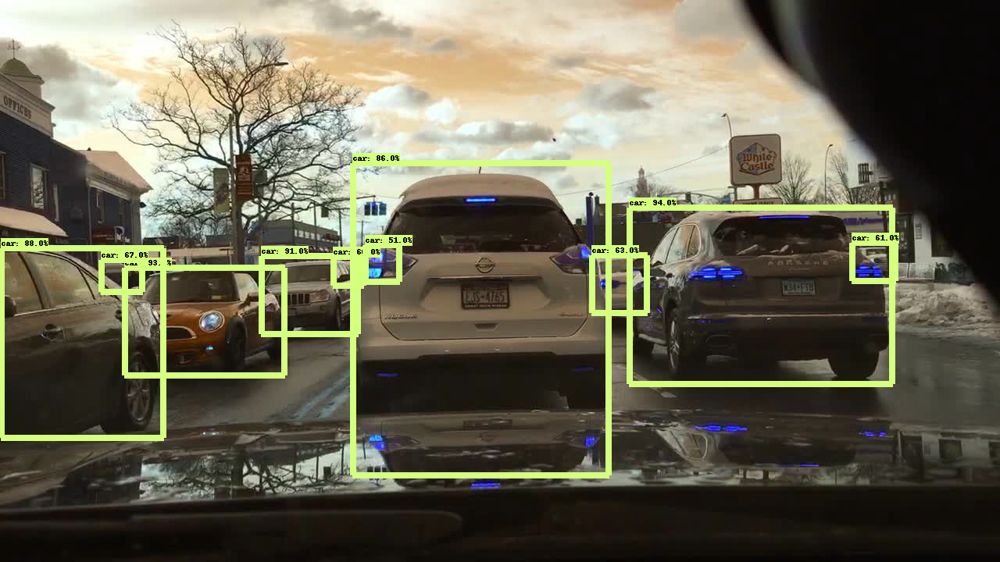

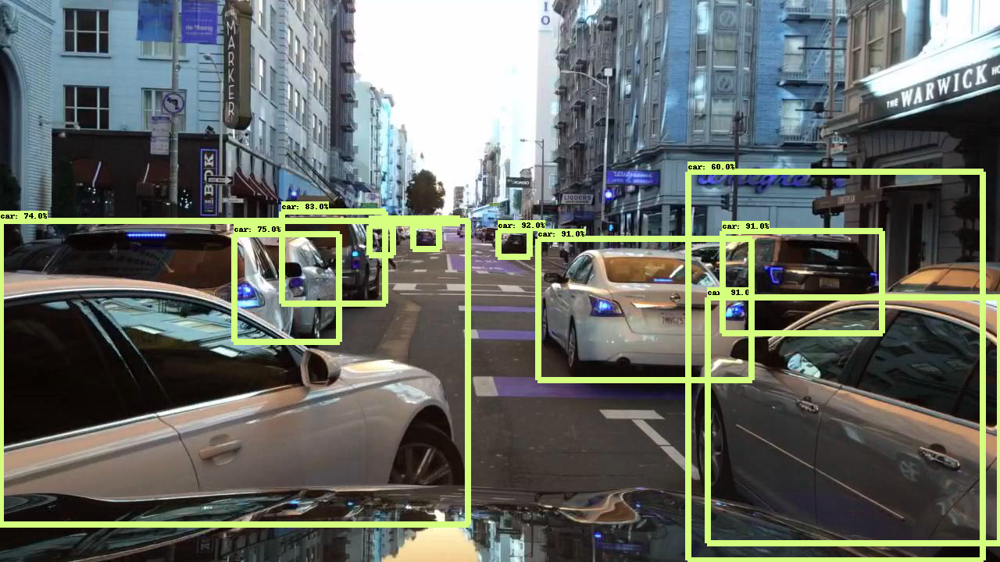

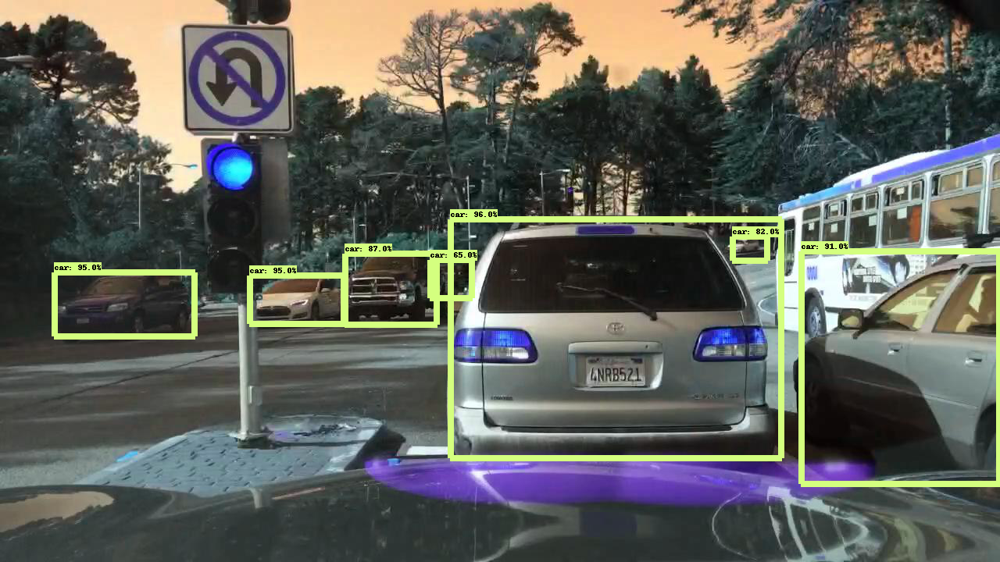

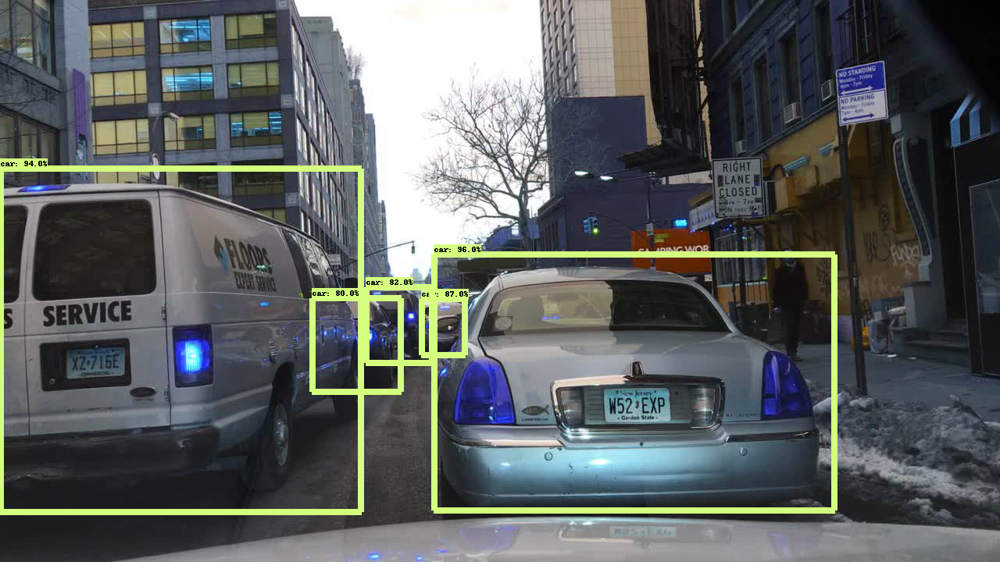

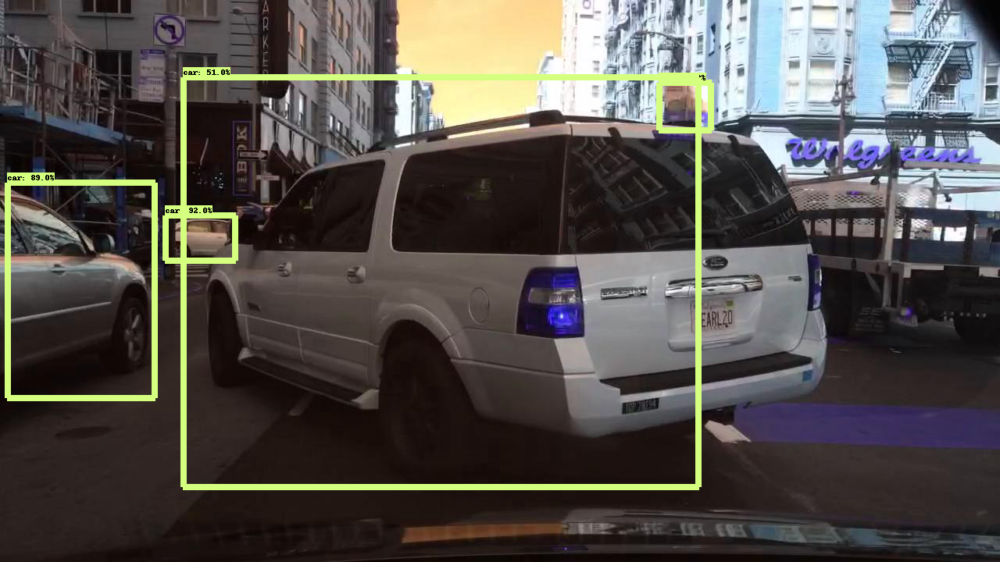

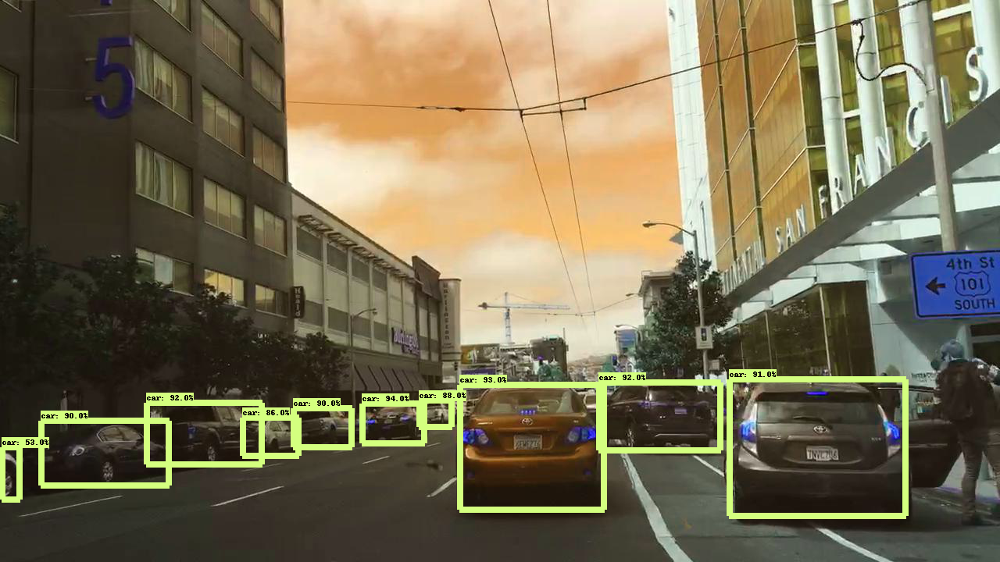

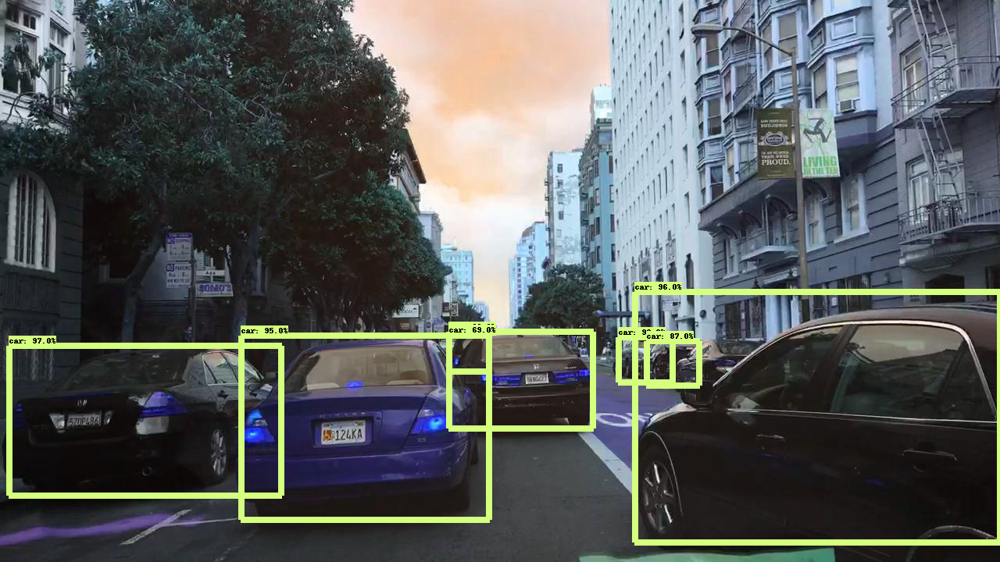

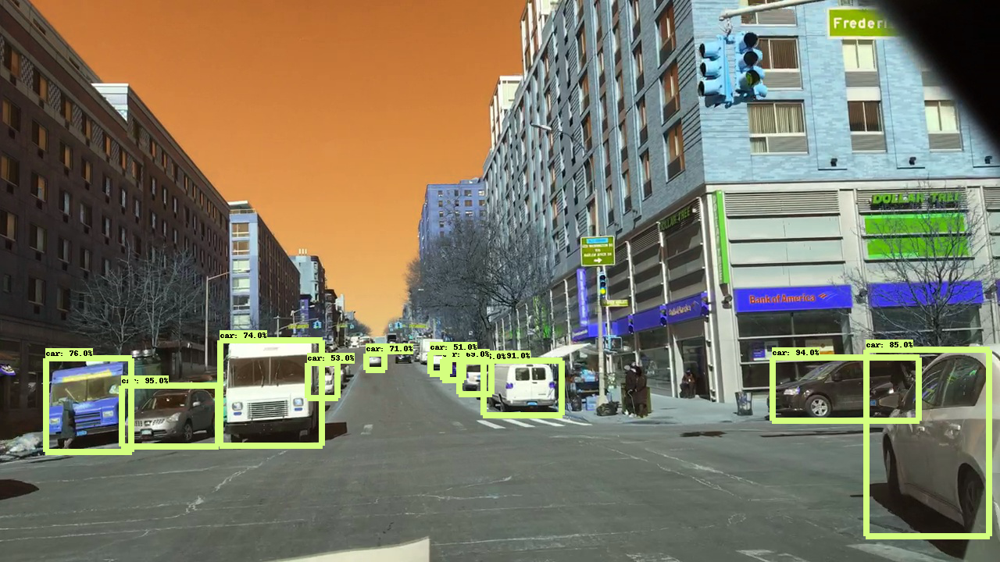

In [ ]:
from google.colab.patches import cv2_imshow

for image_path in TEST_IMAGE_PATHS:
  image = Image.open(image_path)
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = load_image_into_numpy_array(image)
  # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
  image_np_expanded = np.expand_dims(image_np, axis=0)
  # Actual detection.
  output_dict = run_inference_for_single_image(image_np, detection_graph)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks'),
      use_normalized_coordinates=True,
      line_thickness=8)
  plt.figure(figsize=IMAGE_SIZE)
  #plt.imshow(image_np)
  cv2_imshow(image_np)

## 10. Download all the contents of the runtime for backup.

In [ ]:
!zip -r transfer_learning.zip /content/ -x "/content/drive/*"

Scanning files .......................................................................................
  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/gce (stored 0%)
  adding: content/.config/configurations/ (stored 0%)
  adding: content/.config/configurations/config_default (deflated 15%)
  adding: content/.config/.last_opt_in_prompt.yaml (stored 0%)
  adding: content/.config/.last_update_check.json (deflated 22%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2020.07.30/ (stored 0%)
  adding: content/.config/logs/2020.07.30/16.29.12.069758.log (deflated 92%)
  adding: content/.config/logs/2020.07.30/16.30.04.899171.log (deflated 54%)
  adding: content/.config/logs/2020.07.30/16.29.49.434074.log (deflated 53%)
  adding: content/.config/logs/2020.07.30/16.30.04.254570.log (deflated 55%)
  adding: content/.config/logs/2020.07.30/16.29.44.119840.log (deflated 87%)
  adding: content/.config/logs/2020.07.30/16.29.

In [ ]:
# Time left in colab session
import time, psutil
uptime = time.time() - psutil.boot_time()
remain = 12*60*60 - uptime
print(remain)

12728.06507563591


In [ ]:
!zip -r transfer_learning2.zip /content/ -x "/content/drive/*" "/content/models/bdd/images/*"

Scanning files ...............................................................
  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/gce (stored 0%)
  adding: content/.config/configurations/ (stored 0%)
  adding: content/.config/configurations/config_default (deflated 15%)
  adding: content/.config/.last_opt_in_prompt.yaml (stored 0%)
  adding: content/.config/.last_update_check.json (deflated 22%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2020.07.30/ (stored 0%)
  adding: content/.config/logs/2020.07.30/16.29.12.069758.log (deflated 92%)
  adding: content/.config/logs/2020.07.30/16.30.04.899171.log (deflated 54%)
  adding: content/.config/logs/2020.07.30/16.29.49.434074.log (deflated 53%)
  adding: content/.config/logs/2020.07.30/16.30.04.254570.log (deflated 55%)
  adding: content/.config/logs/2020.07.30/16.29.44.119840.log (deflated 87%)
  adding: content/.config/logs/2020.07.30/16.29.30.511119.log (deflated 

`%tensorflow_version` only switches the major version: 1.x or 2.x.
You set: `1.x  # Version 1 is better suited for transfer learning`. This will be interpreted as: `1.x`.


TensorFlow is already loaded. Please restart the runtime to change versions.
Name: tensorflow
Version: 1.15.2
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /tensorflow-1.15.2/python3.6
Requires: tensorflow-estimator, astor, absl-py, grpcio, wrapt, numpy, termcolor, opt-einsum, wheel, tensorboard, keras-applications, google-pasta, keras-preprocessing, six, gast, protobuf
Required-by: stable-baselines, magenta, fancyimpute
/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research


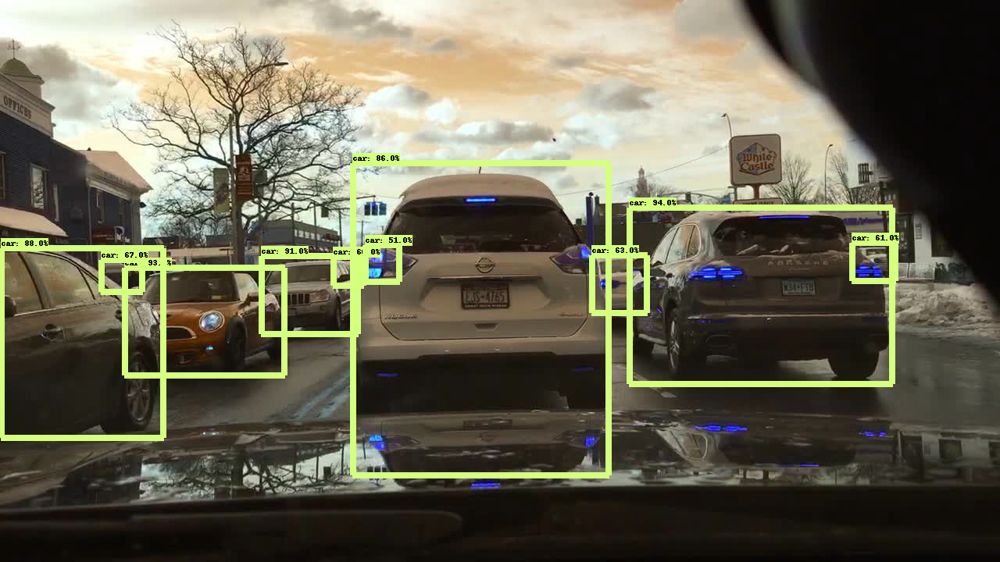

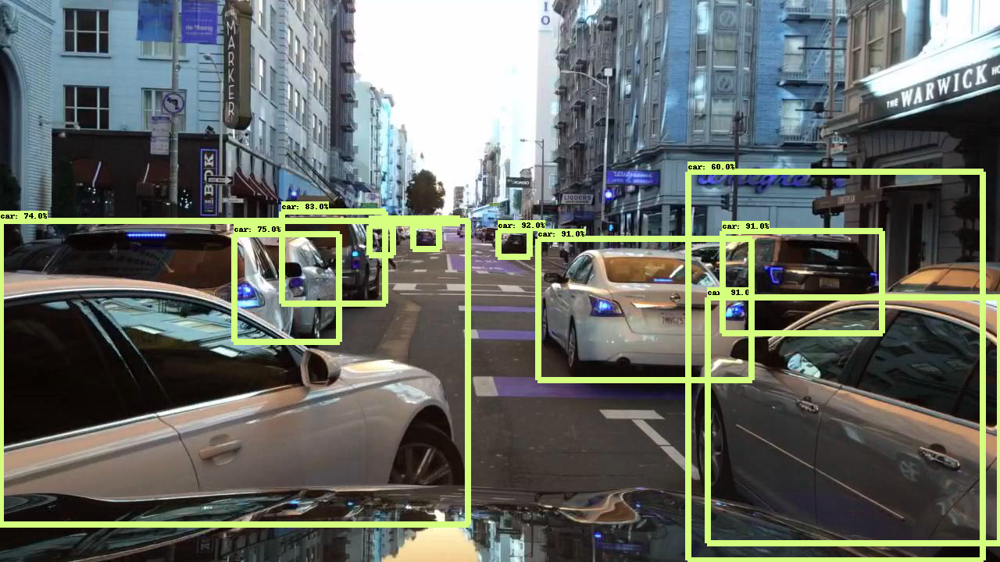

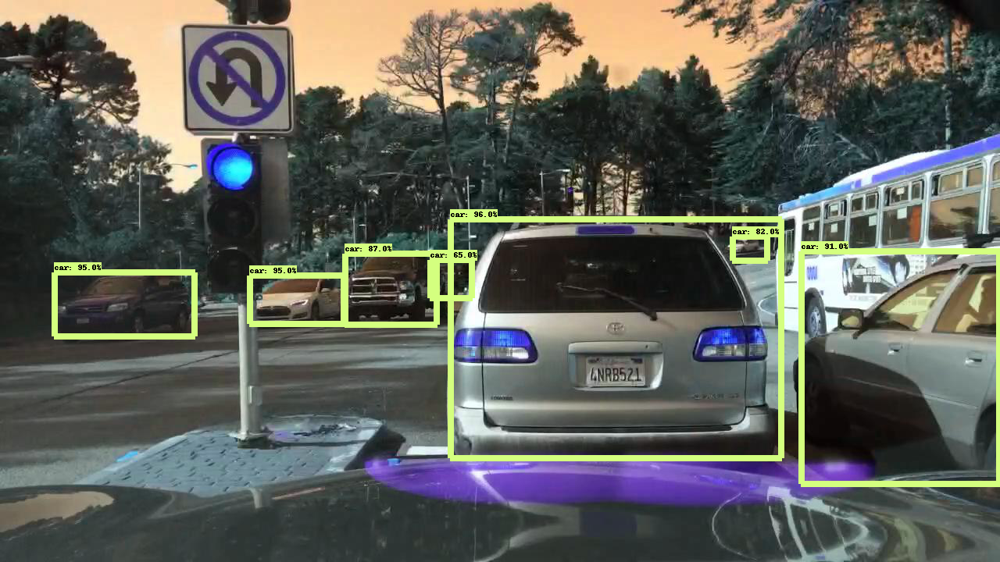

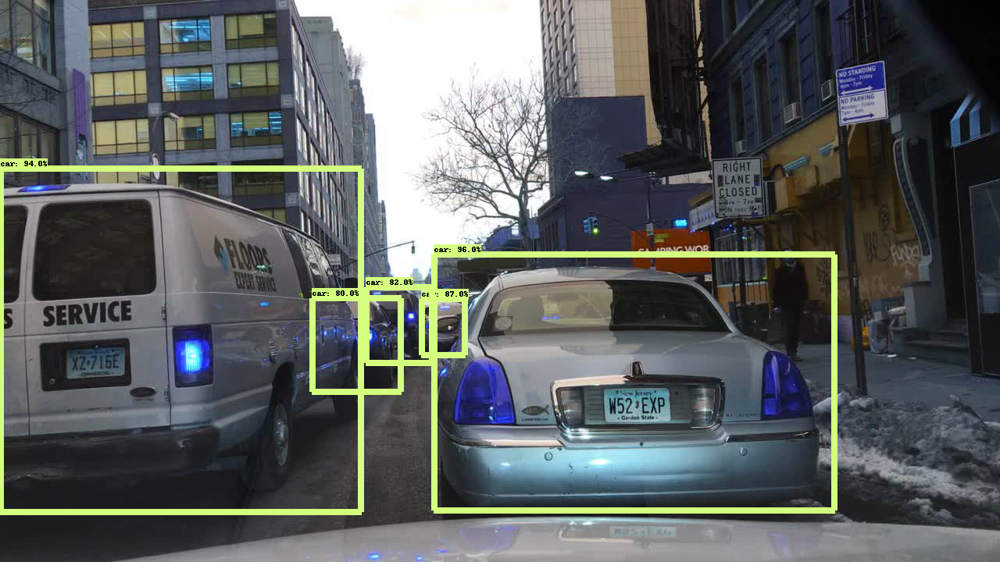

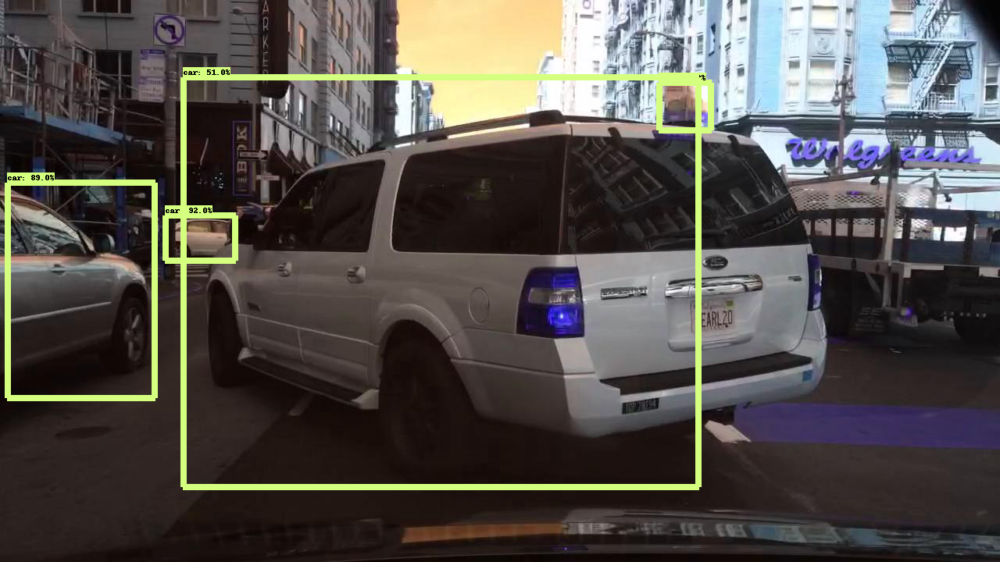

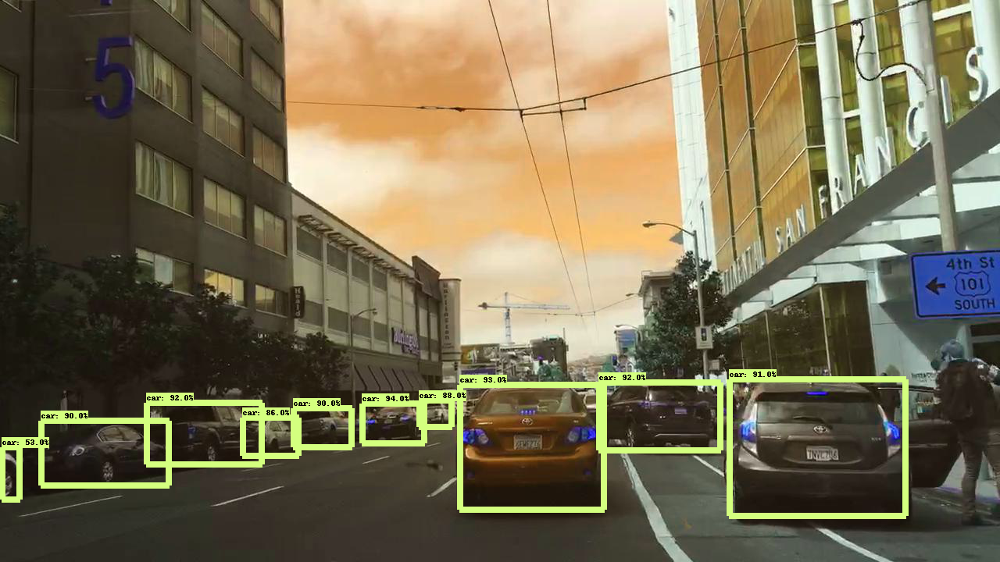

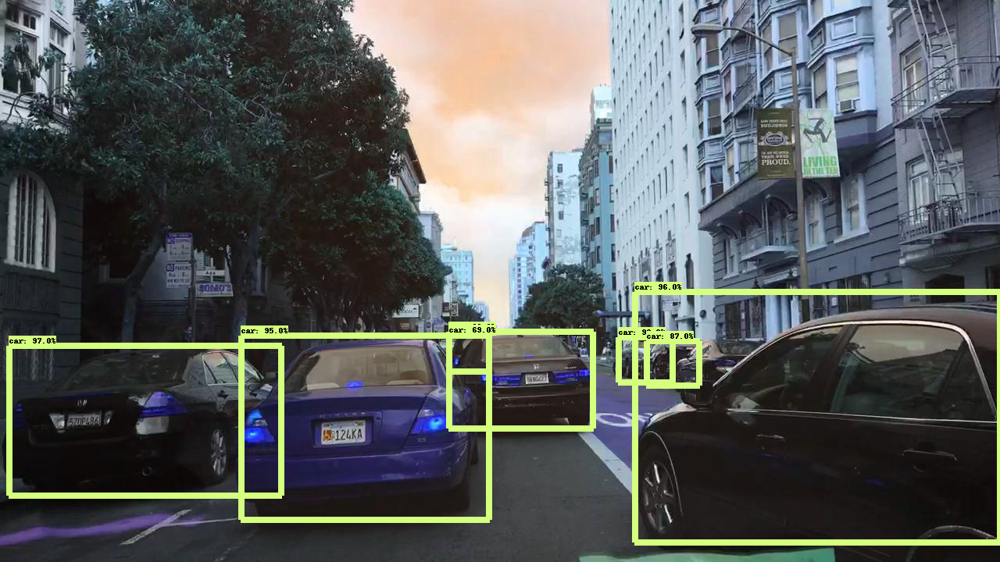

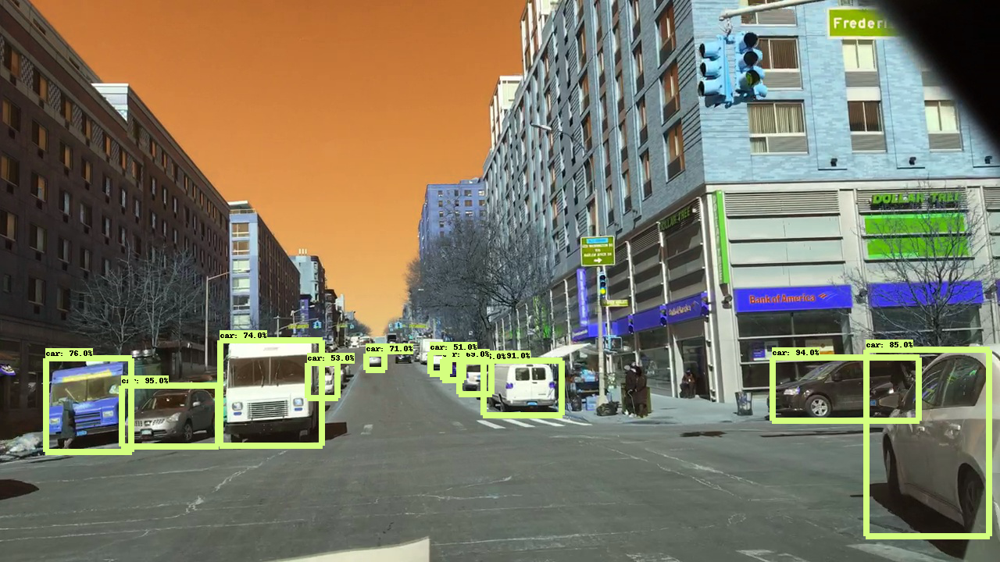

<Figure size 864x576 with 0 Axes>

<Figure size 864x576 with 0 Axes>

<Figure size 864x576 with 0 Axes>

<Figure size 864x576 with 0 Axes>

<Figure size 864x576 with 0 Axes>

<Figure size 864x576 with 0 Axes>

<Figure size 864x576 with 0 Axes>

<Figure size 864x576 with 0 Axes>

In [ ]:
%tensorflow_version 1.x  # Version 1 is better suited for transfer learning
!pip show tensorflow


%cd /content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/
!protoc object_detection/protos/*.proto --python_out=.
import os
os.environ['PYTHONPATH'] += ':/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/research/slim/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection/utils/:/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning/models/research/object_detection'
!python object_detection/builders/model_builder_test.py



import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image



# This is needed to display the images.
%matplotlib inline
import pathlib
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util
from object_detection.utils import label_map_util

from object_detection.utils import visualization_utils as vis_util

import cv2


#cap = cv2.VideoCapture(0)   # if you have multiple webcams change the value to the correct one


# Any model exported using the `export_inference_graph.py` tool can be loaded here simply by changing `PATH_TO_CKPT` to point to a new .pb file.
#
# By default we use an "SSD with Mobilenet" model here. See the [detection model zoo](https://github.com/tensorflow/models/blob/master/object_detection/g3doc/detection_model_zoo.md) for a list of other models that can be run out-of-the-box with varying speeds and accuracies.

# In[4]:

# What model to download.
MODEL_NAME = 'fine_tuned_model'  # change to whatever folder has the new graph
# MODEL_FILE = MODEL_NAME + '.tar.gz'   # these lines not needed as we are using our own model
# DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'

FROZEN_GRAPH_BASE_LOCATION = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/'
# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = FROZEN_GRAPH_BASE_LOCATION + MODEL_NAME + '/frozen_inference_graph.pb'

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/data/object_detection.pbtxt'

NUM_CLASSES = 10  # we are only using one class in this example (cloth_mask)

# we don't need to download model since we have our own
# ## Download Model

# In[5]:
#
# opener = urllib.request.URLopener()
# opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)
# tar_file = tarfile.open(MODEL_FILE)
# for file in tar_file.getmembers():
#     file_name = os.path.basename(file.name)
#     if 'frozen_inference_graph.pb' in file_name:
#         tar_file.extract(file, os.getcwd())


# ## Load a (frozen) Tensorflow model into memory.

# In[6]:

detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')


# ## Loading label map
# Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

# In[7]:

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)


# ## Helper code

# In[8]:

def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)


# # Detection

# In[9]:

# For the sake of simplicity we will use only 2 images:
# image1.jpg
# image2.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = '/content/drive/My Drive/Sem2/DMML2/ProjectCode/Transfer_Learning_KITTI/models/bdd/images/test/'
TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_TEST_IMAGES_DIR, 'image{}.jpg'.format(i)) for i in range(1, 9) ]  # change this value if you want to add more pictures to test

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)


# In[10]:

def run_inference_for_single_image(image, graph):
  with graph.as_default():
    with tf.Session() as sess:
      # Get handles to input and output tensors
      ops = tf.get_default_graph().get_operations()
      all_tensor_names = {output.name for op in ops for output in op.outputs}
      tensor_dict = {}
      for key in [
          'num_detections', 'detection_boxes', 'detection_scores',
          'detection_classes', 'detection_masks'
      ]:
        tensor_name = key + ':0'
        if tensor_name in all_tensor_names:
          tensor_dict[key] = tf.get_default_graph().get_tensor_by_name(
              tensor_name)
      if 'detection_masks' in tensor_dict:
        # The following processing is only for single image
        detection_boxes = tf.squeeze(tensor_dict['detection_boxes'], [0])
        detection_masks = tf.squeeze(tensor_dict['detection_masks'], [0])
        # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
        real_num_detection = tf.cast(tensor_dict['num_detections'][0], tf.int32)
        detection_boxes = tf.slice(detection_boxes, [0, 0], [real_num_detection, -1])
        detection_masks = tf.slice(detection_masks, [0, 0, 0], [real_num_detection, -1, -1])
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
            detection_masks, detection_boxes, image.shape[0], image.shape[1])
        detection_masks_reframed = tf.cast(
            tf.greater(detection_masks_reframed, 0.5), tf.uint8)
        # Follow the convention by adding back the batch dimension
        tensor_dict['detection_masks'] = tf.expand_dims(
            detection_masks_reframed, 0)
      image_tensor = tf.get_default_graph().get_tensor_by_name('image_tensor:0')

      # Run inference
      output_dict = sess.run(tensor_dict,
                             feed_dict={image_tensor: np.expand_dims(image, 0)})

      # all outputs are float32 numpy arrays, so convert types as appropriate
      output_dict['num_detections'] = int(output_dict['num_detections'][0])
      output_dict['detection_classes'] = output_dict[
          'detection_classes'][0].astype(np.uint8)
      output_dict['detection_boxes'] = output_dict['detection_boxes'][0]
      output_dict['detection_scores'] = output_dict['detection_scores'][0]
      if 'detection_masks' in output_dict:
        output_dict['detection_masks'] = output_dict['detection_masks'][0]
  return output_dict


from google.colab.patches import cv2_imshow

for image_path in TEST_IMAGE_PATHS:
  image = Image.open(image_path)
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = load_image_into_numpy_array(image)
  # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
  image_np_expanded = np.expand_dims(image_np, axis=0)
  # Actual detection.
  output_dict = run_inference_for_single_image(image_np, detection_graph)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks'),
      use_normalized_coordinates=True,
      line_thickness=8)
  plt.figure(figsize=IMAGE_SIZE)
  #plt.imshow(image_np)
  cv2_imshow(image_np)

In [ ]:
!pip install tf_slim

     |████████████████████████████████| 358kB 2.8MB/s 
